In [1]:
!pip install --quiet pytorch-lightning

     |████████████████████████████████| 701 kB 33.5 MB/s 
     |████████████████████████████████| 5.8 MB 57.5 MB/s 
     |████████████████████████████████| 419 kB 55.8 MB/s 
     |████████████████████████████████| 141 kB 62.3 MB/s 
     |████████████████████████████████| 596 kB 57.9 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.9.1 which is incompatible.


In [3]:
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import json
import plotly.graph_objects as go
import pandas as pd
import torch
import pytorch_lightning as pl

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from tqdm import tqdm
from IPython.display import HTML
from sklearn.preprocessing import LabelEncoder
from os import cpu_count

import torch.autograd as autograd
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn.modules import dropout

from multiprocessing import cpu_count
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from torchmetrics.functional import accuracy
from sklearn.metrics import classification_report, confusion_matrix


pl.seed_everything(42)

float_formatter = "{:.8f}".format
np.set_printoptions(formatter={'float_kind':float_formatter})



def print_yellow(text): print("\033[93m {}\033[00m".format(text))


def print_bold(text): print(f"\033[1m {text} \033[0m")


def read_json(path):
  with open(path, 'r') as file_in:
     return json.load(file_in)


def max_listoflists_lenght(l, verbose=False):
  """l is a list of lists"""
  max_lenght = 0
  for i in l:
    if max_lenght < len(i):
      max_lenght = len(i)
  if verbose:
    print("min_lenght: ", min_listoflists_lenght(l))
    print("max_lenght: ", max_lenght)
  return max_lenght


def min_listoflists_lenght(l):
  """l is a list of lists"""
  min_lenght = 999999
  for i in l:
    if min_lenght > len(i):
      min_lenght = len(i)
  return min_lenght


def normalize(l, verbose=False):
  l = (l - np.mean(l)) / np.std(l)
  l = [i.tolist() for i in l]
  if verbose:
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l))
  return l


def normalize_lenghts(l, verbose=False):
  """l is a list of lists"""
  max_lenght = max_listoflists_lenght(l, verbose)
  new_l = [np.interp(np.linspace(0, 1, max_lenght).astype('float'), np.linspace(0, 1, len(l_i)).astype('float'), l_i) for l_i in l]
  if verbose:
    min_listoflists_lenght(l)
  return new_l


def plot_collection(plot_only_this:str, distances_collection,
                    number_of_desired_plots=0):
  
  """this method takes the distances_collection for one user and a specific 
      pattern plot_only_this and add traces in the same graph until the 
      number_of_desired_plots is reached; if 0 then plot all"""

      # todo: there is a lot of redundancy, you could clear a lot of lines

  fig = go.Figure()
  plots_count = 0
  print("total number of graphs: ", len(distances_collection))

  for (pattern_name, d) in distances_collection:
    if pattern_name == plot_only_this:
      if plots_count ==0:
        fig.add_trace(go.Line(y=d))
        fig.update_layout(title=plot_only_this)
      else:
        fig.add_trace(go.Line(y=d))
      plots_count += 1
      fig.update_layout(width=1200, height=800)
      if number_of_desired_plots:
        if plots_count == number_of_desired_plots:
          break

  print("plots: ", plots_count)
  return fig


def plot_experiment(name:str, l, normal=False, normal_only=False, verbose=False):
  if verbose:
    print("raw: ")
    print("max: ", max(l))
    print("mean: ", np.mean(l))
    print("std: ", np.std(l), end="\n\n")
    
  fig = go.Figure()
  fig.update_layout(title=name)
  fig.update_layout(width=1200, height=800)
  if not normal_only:
    fig.add_trace(go.Line(name="raw", y=l))

  if normal:
    l_normal = normalize(l, verbose=verbose)
    fig.add_trace(go.Line(name="nomalized", y=l_normal))
      
  return fig

Global seed set to 42


In [4]:
# read distances_collection for each participant: list of tuples(pattern_name, list)
# todo: walk the data folder and get .txt and extract names
PARTICIPANTS = ["Anoth", "Arif", "Ashok", "Gowthom", "Josephin", "Raghu"]

anoth = read_json("AnothDistance.txt")
arif = read_json("ArifDistance.txt")
ashok = read_json("AshokDistance.txt")
gowthom = read_json("GowthomDistance.txt")
josephin = read_json("JosephinDistance.txt")
raghu = read_json("RaghuDistance.txt")

In [7]:
# original plot for all attempts of the same pattern for a specific user

HTML(plot_collection("pattern2", josephin).to_html())

total number of graphs:  90
plots:  15


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [8]:
# Build the Dataframe

data_generator = [anoth, arif, ashok, gowthom, josephin, raghu], ["Anoth", "Arif", "Ashok", "Gowthom", "Josephin", "Raghu"]  # data, name

print("number of collections (participants): ", len(data_generator[0]), end="\n\n")
df_concat = pd.DataFrame()
for ix, (participant_data, participant_name) in enumerate(zip(data_generator[0], data_generator[1])):
  df = pd.DataFrame(participant_data, columns=["pattern_name", "ts_data"])
  df["participant_name"] = participant_name
  print(f"{len(participant_data)} rows are being been added for {participant_name}...")
  df_concat = pd.concat([df_concat, df], ignore_index=True) if ix>0 else df
print(f"\nDataFrame has now {len(df_concat.ts_data)} samples...")

number of collections (participants):  6

90 rows are being been added for Anoth...
90 rows are being been added for Arif...
90 rows are being been added for Ashok...
90 rows are being been added for Gowthom...
90 rows are being been added for Josephin...
90 rows are being been added for Raghu...

DataFrame has now 540 samples...


In [9]:
df_concat = df_concat[["participant_name", "pattern_name", "ts_data"]]
df_concat

,participant_name,pattern_name,ts_data
0,Anoth,pattern3,"[0.028236091136932373, 0.02845382690429687, 0...."
1,Anoth,pattern6,"[0.011750409007072443, 0.011113771796226496, 0..."
2,Anoth,pattern1,"[0.011152797937393183, 0.013134115934371943, 0..."
3,Anoth,pattern3,"[0.029294610023498535, 0.027973294258117676, 0..."
4,Anoth,pattern4,"[0.019884237647056574, 0.0176079511642456, 0.0..."
...,...,...,...
535,Raghu,pattern5,"[0.03295974981282496, 0.03370579824891975, 0.0..."
536,Raghu,pattern6,"[0.04583717286586761, 0.0432017832994461, 0.04..."
537,Raghu,pattern3,"[0.020403385162353516, 0.01948988437652588, 0...."
538,Raghu,pattern5,"[0.03012125176442872, 0.030831037806490692, 0...."


In [177]:
duplicate_counts = {'False':0, 'True':0}
df_concat_copy = df_concat.copy()
df_concat_copy['ts_data'] = df_concat['ts_data'].astype("string")

for boo in df_concat_copy.duplicated().tolist():
  duplicate_counts[str(boo)]+=1

duplicate_counts

{'False': 540, 'True': 0}

In [10]:
# original+normal data plot for single experiment

HTML(plot_experiment(name="pattern2", l=df_concat.ts_data.tolist()[50], normal=True, normal_only=False, verbose=True).to_html())  # first item is anoth pattern3 for sure

raw: 
max:  0.04768147630561743
mean:  0.015316386471969857
std:  0.011810959310791215

max:  2.7402591933473888
mean:  1.8419609272190098e-16
std:  1.0


/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




In [11]:
# Normalize ALL (also by lenght)

df_concat.ts_data = df_concat.ts_data.apply(normalize)
df_concat.ts_data = normalize_lenghts(df_concat.ts_data.tolist())

print("normalized_lenghts:  ", end="")
for l in df_concat.ts_data.tolist():
  print(len(l), end=",  ")
print("\n")
df_concat

normalized_lenghts:  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  374,  3

,participant_name,pattern_name,ts_data
0,Anoth,pattern3,"[0.03522027086311766, 0.037449768485506844, 0...."
1,Anoth,pattern6,"[-0.4077706586340066, -0.4091080820194971, -0...."
2,Anoth,pattern1,"[-0.581463717632903, -0.5741071271467633, -0.5..."
3,Anoth,pattern3,"[-0.9057351453786462, -0.9185414432095051, -0...."
4,Anoth,pattern4,"[0.02102541949408563, -0.0027091352251100258, ..."
...,...,...,...
535,Raghu,pattern5,"[-0.09302460458811557, -0.08700121045432074, -..."
536,Raghu,pattern6,"[-0.3273991393629674, -0.33209689576231793, -0..."
537,Raghu,pattern3,"[-0.36167824999401693, -0.37182792250728164, -..."
538,Raghu,pattern5,"[-0.8252872829893982, -0.8219826258107576, -0...."


In [201]:
duplicate_counts = {'False':0, 'True':0}
df_concat_copy = df_concat.copy()
df_concat_copy['ts_data'] = df_concat['ts_data'].astype("string")

for boo in df_concat_copy.duplicated().tolist():
  duplicate_counts[str(boo)]+=1

duplicate_counts

{'False': 540, 'True': 0}

In [29]:
# FEATURE SELECTION --> EXPLODE THE DATAFRAME TS_DATA

for ix, series in tqdm(df_concat.iterrows(), total=len(df_concat)):
  series_df = pd.DataFrame(series.ts_data, columns=["trace_difference"])
  series_df["participant_name"] = series.participant_name
  series_df["pattern_name"] = series.pattern_name
  series_df["series_id"] = ix
  series_df = series_df[["participant_name", "pattern_name", "series_id", "trace_difference"]]
  X = series_df if ix==0 else pd.concat([X, series_df])

# filter dfs selecting the desired features

FEATURES = ["pattern_name", "trace_difference"]
PREDICTION_TARGET = "participant_name"

y = X[["series_id", "pattern_name", "participant_name"]]
y = y[["series_id", PREDICTION_TARGET]]

X_columns = ["series_id"]
X_columns.extend(FEATURES)
X = X[X_columns]

y.reset_index(inplace=True)
del y["index"]
X.reset_index(inplace=True)
del X["index"]

print(f"\nX: {len(X)}; y: {len(y)}; equal? {len(X)==len(y)}")

100%|██████████| 540/540 [00:02<00:00, 244.29it/s]


X: 201960; y: 201960; equal? True


In [13]:
duplicate_counts = {'False':0, 'True':0}

for boo in X.duplicated().tolist():
  duplicate_counts[str(boo)]+=1

duplicate_counts

{'False': 196636, 'True': 5324}

In [232]:
# remove duplicates and corresponding row in y dataframe
# X.drop_duplicates(inplace=True)
# y = y.iloc[X.index.tolist()]
# len(y)

196636

In [290]:
duplicate_counts = {'False':0, 'True':0}

for boo in X.duplicated().tolist():
  duplicate_counts[str(boo)]+=1

duplicate_counts

{'False': 196636, 'True': 5324}

In [30]:
display(X)

print(f"\nConsidering {len(PARTICIPANTS)} participants with {len(anoth)} experiments each, we have {len(PARTICIPANTS) * len(anoth)} number of samples or single graphs.\n\
Naturally the lenght of the time-series for a single experiment is dependent on the speed of the user at that pattern attempt. \n\
The absolute minimum lenght for this data collection is {min_listoflists_lenght(df_concat.ts_data.tolist())} and the maximum {max_listoflists_lenght(df_concat.ts_data.tolist())}. \n\
After normalization, all time series have the same lenght: {max_listoflists_lenght(df_concat.ts_data.tolist())}. \n\
Therefore, each equal-lenght time series (one single row) can be exploded into {max_listoflists_lenght(df_concat.ts_data.tolist())} rows. \n\
In order to identify the original row index before exploding, a new column 'series_id' is added to de dataframe. \n\
Ergo, the total number of samples for my new dataframes X and y is {len(PARTICIPANTS) * len(anoth) * max_listoflists_lenght(df_concat.ts_data.tolist())}. \n\
Now, X dataframe after exploding contains exactly {duplicate_counts['True']} duplicate rows. They need to be removed for a long to wide table transformation, \n\
leaving {len(PARTICIPANTS) * len(anoth) * max_listoflists_lenght(df_concat.ts_data.tolist()) - duplicate_counts['True']} unique samples.")

,series_id,pattern_name,trace_difference
0,0,pattern3,0.035220
1,0,pattern3,0.037450
2,0,pattern3,0.039679
3,0,pattern3,0.041909
4,0,pattern3,0.044138
...,...,...,...
201955,539,pattern4,-1.252073
201956,539,pattern4,-1.216365
201957,539,pattern4,-1.180656
201958,539,pattern4,-1.144948



Considering 6 participants with 90 experiments each, we have 540 number of samples or single graphs.
Naturally the lenght of the time-series for a single experiment is dependent on the speed of the user at that pattern attempt. 
The absolute minimum lenght for this data collection is 374 and the maximum 374. 
After normalization, all time series have the same lenght: 374. 
Therefore, each equal-lenght time series (one single row) can be exploded into 374 rows. 
In order to identify the original row index before exploding, a new column 'series_id' is added to de dataframe. 
Ergo, the total number of samples for my new dataframes X and y is 201960. 
Now, X dataframe after exploding contains exactly 5324 duplicate rows. They need to be removed for a long to wide table transformation, 
leaving 196636 unique samples.


In [31]:
# labels
y

,series_id,participant_name
0,0,Anoth
1,0,Anoth
2,0,Anoth
3,0,Anoth
4,0,Anoth
...,...,...
201955,539,Raghu
201956,539,Raghu
201957,539,Raghu
201958,539,Raghu


data class distribution after transformations...

Anoth       33660
Arif        33660
Ashok       33660
Gowthom     33660
Josephin    33660
Raghu       33660
Name: participant_name, dtype: int64




(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

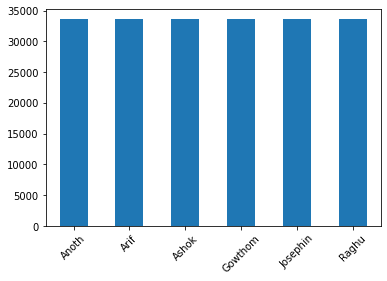

In [32]:
print("data class distribution after transformations...\n")
print(y.participant_name.value_counts())
print("\n")
y.participant_name.value_counts().plot(kind="bar")
plt.xticks(rotation=45)

In [33]:
# encode pattern_name using LabelEncoder()

pattern_encoder = LabelEncoder()

encoded_patterns = pattern_encoder.fit_transform(X.pattern_name)
print({k:v for k, v in zip(pattern_encoder.classes_.tolist(), set(encoded_patterns))})

{'pattern1': 0, 'pattern2': 1, 'pattern3': 2, 'pattern4': 3, 'pattern5': 4, 'pattern6': 5}


In [34]:
X["pattern_id"] = encoded_patterns
X.reset_index(inplace=True)
del X["index"]
X

,series_id,pattern_name,trace_difference,pattern_id
0,0,pattern3,0.035220,2
1,0,pattern3,0.037450,2
2,0,pattern3,0.039679,2
3,0,pattern3,0.041909,2
4,0,pattern3,0.044138,2
...,...,...,...,...
201955,539,pattern4,-1.252073,3
201956,539,pattern4,-1.216365,3
201957,539,pattern4,-1.180656,3
201958,539,pattern4,-1.144948,3


In [296]:
duplicate_counts = {'False':0, 'True':0}

for boo in X.duplicated().tolist():
  duplicate_counts[str(boo)]+=1

duplicate_counts

{'False': 196636, 'True': 5324}

In [260]:
# X['participant_name'] = y['participant_name']
# del X["pattern_id"]
# X_piv=X.pivot(index=['participant_name', 'series_id'], columns='pattern_name', values='trace_difference')
# X_piv

X_new = X.set_index(['participant_name', 'series_id', 'pattern_name'], append=True)
X_new = X_new.unstack(3)

In [261]:
X_new

trace_difference                     \
pattern_name                              pattern1 pattern2  pattern3   
       participant_name series_id                                       
0      Anoth            0                      NaN      NaN  0.035220   
1      Anoth            0                      NaN      NaN  0.037450   
2      Anoth            0                      NaN      NaN  0.039679   
3      Anoth            0                      NaN      NaN  0.041909   
4      Anoth            0                      NaN      NaN  0.044138   
...                                            ...      ...       ...   
196631 Raghu            539                    NaN      NaN       NaN   
196632 Raghu            539                    NaN      NaN       NaN   
196633 Raghu            539                    NaN      NaN       NaN   
196634 Raghu            539                    NaN      NaN       NaN   
196635 Raghu            539                    NaN      NaN       NaN   

                                                               
pattern_name                       pattern4 pattern5 pattern6  
       participant_name series_id                              
0      Anoth            0               NaN      NaN      NaN  
1      Anoth            0               NaN      NaN      NaN  
2      Anoth            0               NaN      NaN      NaN  
3      Anoth            0               NaN      NaN      NaN  
4      Anoth            0               NaN      NaN      NaN  
...                                     ...      ...      ...  
196631 Raghu            539       -1.252073      NaN      NaN  
196632 Raghu            539       -1.216365      NaN      NaN  
196633 Raghu            539       -1.180656      NaN      NaN  
196634 Raghu            539       -1.144948      NaN      NaN  
196635 Raghu            539       -1.109240      NaN      NaN  

[196636 rows x 6 columns]

## PATTERN3 CLASSIFIER

In [35]:
# get only samples for one pattern3

is_pattern2 =  X['pattern_name']=="pattern2"
is_pattern3 =  X['pattern_name']=="pattern3"

# filter rows for year 2002 using  the boolean variable
X_pattern2 = X[is_pattern2]
X_pattern3 = X[is_pattern3]

In [36]:
X_pattern2

,series_id,pattern_name,trace_difference,pattern_id
2244,6,pattern2,-0.284603,1
2245,6,pattern2,-0.284532,1
2246,6,pattern2,-0.284462,1
2247,6,pattern2,-0.284391,1
2248,6,pattern2,-0.284320,1
...,...,...,...,...
200085,534,pattern2,-0.755013,1
200086,534,pattern2,-0.757090,1
200087,534,pattern2,-0.759167,1
200088,534,pattern2,-0.761244,1


In [37]:
y_pattern3 = y.iloc[X_pattern3.index.tolist()]
y_pattern2 = y.iloc[X_pattern2.index.tolist()]
len(y_pattern2)

33660

In [38]:
X = X_pattern2

In [39]:
del X['pattern_name']
del X['pattern_id']
X

,series_id,trace_difference
2244,6,-0.284603
2245,6,-0.284532
2246,6,-0.284462
2247,6,-0.284391
2248,6,-0.284320
...,...,...
200085,534,-0.755013
200086,534,-0.757090
200087,534,-0.759167
200088,534,-0.761244


In [40]:
y = y_pattern2
y

,series_id,participant_name
2244,6,Anoth
2245,6,Anoth
2246,6,Anoth
2247,6,Anoth
2248,6,Anoth
...,...,...
200085,534,Raghu
200086,534,Raghu
200087,534,Raghu
200088,534,Raghu


In [41]:
FEATURE_COLUMNS = X.columns.tolist()[1:]
FEATURE_COLUMNS

['trace_difference']

In [42]:
# encode labels: participant_name

label_encoder = LabelEncoder()

encoded_labels = label_encoder.fit_transform(y.participant_name)
print({k:v for k, v in zip(label_encoder.classes_.tolist(), set(encoded_labels))})

{'Anoth': 0, 'Arif': 1, 'Ashok': 2, 'Gowthom': 3, 'Josephin': 4, 'Raghu': 5}


In [43]:
y["label"] = encoded_labels
y.reset_index(inplace=True)
del y["index"]
y

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,series_id,participant_name,label
0,6,Anoth,0
1,6,Anoth,0
2,6,Anoth,0
3,6,Anoth,0
4,6,Anoth,0
...,...,...,...
33655,534,Raghu,5
33656,534,Raghu,5
33657,534,Raghu,5
33658,534,Raghu,5


In [44]:
# train, val, test split stratifies (balanced)

targets = []
data = []
for series_id, group in X.groupby("series_id"):
  sequence_features = group[FEATURE_COLUMNS]
  label = y[y.series_id == series_id].iloc[0].label  # all series would have same label so just take one
  data.append(sequence_features)
  targets.append(label)

train_sequences, test_sequences, ytrain, ytest= train_test_split(data, targets, test_size=0.2, random_state = 42, stratify=targets)
train_sequences, val_sequences, ytrain, yval = train_test_split(train_sequences, ytrain, test_size=0.2, random_state = 42, stratify=ytrain)

train_sequences = [(sequence, label) for sequence, label in zip(train_sequences, ytrain)]
test_sequences = [(sequence, label) for sequence, label in zip(test_sequences, ytest)]
val_sequences = [(sequence, label) for sequence, label in zip(val_sequences, yval)]

print("train, val, test")
len(train_sequences), len(val_sequences), len(test_sequences)

train, val, test


(57, 15, 18)

In [45]:
class UserDataset(Dataset):

  def __init__(self, sequences) -> None:
    super().__init__()
    self.sequences = sequences

  def __len__(self):
    return len(self.sequences)

  def __getitem__(self, idx):
    sequence, label = self.sequences[idx]
    return dict(
        sequence=torch.Tensor(sequence.to_numpy()),
        labels=torch.tensor(label).long()
    )
  def pad_sequences(self):
    pass

In [46]:
print("cpu_count: ", cpu_count())

class UserDataModule(pl.LightningDataModule):

  def __init__(self, train_sequences, test_sequences, val_sequences, batch_size):
    super().__init__()
    self.train_sequences = train_sequences
    self.test_sequences = test_sequences
    self.val_sequences = val_sequences
    self.batch_size = batch_size

  def setup(self, stage=None):
    self.train_dataset = UserDataset(self.train_sequences)
    self.test_dataset = UserDataset(self.test_sequences)
    self.val_dataset = UserDataset(self.val_sequences)

  def train_dataloader(self):
    return DataLoader(
        self.train_dataset,
        batch_size = self.batch_size,
        shuffle=True,
        num_workers=cpu_count()
    )

  def val_dataloader(self):
    return DataLoader(
        self.val_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    )

  def test_dataloader(self):
    return DataLoader(
        self.test_dataset,
        batch_size = self.batch_size,
        shuffle=False,
        num_workers=cpu_count()
    ) 

cpu_count:  2


In [70]:
N_EPOCHS = 1000
BATCH_SIZE = 16  # shall the batch size be equal to senquences lenght or it takes a whole seq as 1 of the batch

data_module = UserDataModule(train_sequences, test_sequences, val_sequences, BATCH_SIZE)

In [48]:
# model

class SequenceModel(nn.Module):

  def __init__(self, n_features, n_classes, n_hidden=256, n_layers=3):
    super().__init__()
    # self.n_hidden = n_hidden
    self.lstm = nn.LSTM(
        input_size=n_features,
        hidden_size = n_hidden,
        num_layers=n_layers,
        batch_first = True,
        dropout=0.75   # hyperparameter for regularization
    )
    self.classifier = nn.Linear(n_hidden, n_classes)

  def forward(self, x):
    self.lstm.flatten_parameters()  # for multi_gpu purposes
    _, (hidden, _) = self.lstm(x)
    out = hidden[-1]
    return self.classifier(out)

In [49]:
class UserPredictor(pl.LightningModule):

  def __init__(self, n_features:int, n_classes:int):
    super().__init__()
    self.model = SequenceModel(n_features, n_classes)
    self.criterion = nn.CrossEntropyLoss()

  def forward(self, x, labels=None):
    output = self.model(x)
    loss = 0
    if labels is not None:
      loss = self.criterion(output, labels)
    return loss, output

  def training_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("train_loss", loss, prog_bar=True, logger=True)
    self.log("train_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def validation_step(self, batch, batch_idx):
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)
    
    self.log("val_loss", loss, prog_bar=True, logger=True)
    self.log("val_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def test_step(self, batch, batch_idx):
    print("test step...")
    sequences = batch["sequence"]
    labels = batch["labels"]
    loss, outputs = self(sequences, labels)
    predictions = torch.argmax(outputs, dim=1)
    step_accuracy = accuracy(predictions, labels)

    self.log("test_loss", loss, prog_bar=True, logger=True)
    self.log("test_accuracy", step_accuracy, prog_bar=True, logger=True)
    return {"loss": loss, "accuracy": step_accuracy}

  def configure_optimizers(self):
    return optim.Adam(self.parameters(), lr=0.0001)

# what is top_k accuracy?

In [71]:
model = UserPredictor(
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

In [ ]:
# init tensorboar

%load_ext tensorboard
%tensorboard --logdir ./logs

In [72]:
checkpoint_callback = ModelCheckpoint(
    dirpath= "checkpoints",
    filename= "best-checkpoint",
    save_top_k=1,
    verbose= False,
    monitor="val_loss",
    mode="min"
)

logger = TensorBoardLogger("logs", name="usergaze")

trainer = pl.Trainer(
    logger = logger,
    callbacks=checkpoint_callback,
    max_epochs=N_EPOCHS,
    accelerator="gpu",
    devices=1,
    enable_progress_bar=True,
    log_every_n_steps=1
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [ ]:
!wget -O mini.sh https://repo.anaconda.com/miniconda/Miniconda3-py39_4.9.2-Linux-x86_64.sh
!chmod +x mini.sh
!bash ./mini.sh -b -f -p /usr/local
!conda install -q -y jupyter
!conda install -q -y google-colab -c conda-forge
!python -m ipykernel install --name "py39" --user

In [73]:
import os
os.environ['WANDB_CONSOLE'] = 'off'

trainer.fit(model, data_module)

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:616: UserWarning:

Checkpoint directory /content/checkpoints exists and is not empty.

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | SequenceModel    | 1.3 M 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
1.3 M     Trainable params
0         Non-trainable params
1.3 M     Total params
5.278     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=1000` reached.


In [74]:
from tensorboard import notebook
notebook.list()

No known TensorBoard instances running.


In [75]:
# notebook.display(port=6006, height=1000)

In [76]:
# !tensorboard dev upload --logdir ./logs --name Hierachical_Multivariate_TimeSeries_Classification --one_shot

# 4/1AdQt8qiEllZ4YubRed1cRNDJXTyXv13W9MPySPPPuu6URp_PMZRA9t7qCyk

In [77]:
trainer.test(model, data_module)  
# data_module overall accuracy

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

test step...
test step...
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
      test_accuracy         0.3888888955116272
        test_loss           2.9185216426849365
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_accuracy': 0.3888888955116272, 'test_loss': 2.9185216426849365}]

In [78]:
trained_model = UserPredictor.load_from_checkpoint(
    trainer.checkpoint_callback.best_model_path,   # trainer.checkpoint_callback.best_model_path, ./checkpoints/best-checkpoint-v5.ckpt
    n_features=len(FEATURE_COLUMNS),
    n_classes=len(label_encoder.classes_)
)

trained_model.freeze()

In [79]:
test_dataset = UserDataset(test_sequences)

predictions = []
labels = []

for item in tqdm(test_dataset):
  sequence = item["sequence"]
  label = item["labels"]

  _, output = trained_model(sequence.unsqueeze(dim=0))
  prediction = torch.argmax(output, dim=1)
  predictions.append(prediction.item())
  labels.append(label.item())

100%|██████████| 18/18 [00:01<00:00, 14.77it/s]


In [80]:
print(classification_report(labels, predictions, target_names=label_encoder.classes_))

              precision    recall  f1-score   support

       Anoth       0.14      0.33      0.20         3
        Arif       0.50      0.67      0.57         3
       Ashok       0.00      0.00      0.00         3
     Gowthom       0.00      0.00      0.00         3
    Josephin       1.00      0.33      0.50         3
       Raghu       0.50      0.67      0.57         3

    accuracy                           0.33        18
   macro avg       0.36      0.33      0.31        18
weighted avg       0.36      0.33      0.31        18



In [81]:
# !pip install seaborn
import seaborn as sns

def show_confusion_matrix(confusion_matrix):
  hmap = sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues")
  hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right')
  hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')
  plt.ylabel('True User')
  plt.xlabel('Predicted User')

In [82]:
cm = confusion_matrix(labels, predictions)
df_cm = pd.DataFrame(
    cm, index=label_encoder.classes_, columns=label_encoder.classes_
)
df_cm

,Anoth,Arif,Ashok,Gowthom,Josephin,Raghu
Anoth,1,1,0,0,0,1
Arif,0,2,0,1,0,0
Ashok,2,1,0,0,0,0
Gowthom,1,0,1,0,0,1
Josephin,2,0,0,0,1,0
Raghu,1,0,0,0,0,2


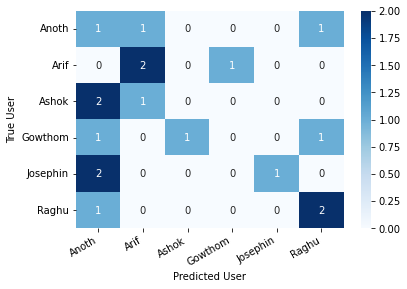

In [83]:
show_confusion_matrix(df_cm)

In [84]:
# todo: reduce batch_size my god!